# Q-Beat: Advanced Music Generation with Bass, Melody & Pitch Control
## Creating Real-Song-Like Compositions with Multiple Instruments

This notebook generates professional music with:
- Independent drum, bass, and melody tracks
- Multiple musical scales and pitch variations
- Different bass patterns and progression
- Chord progressions and harmonies
- Realistic song structure (verse-chorus-bridge)
- Dynamic instrument layering

## Setup: Core Classes

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from qiskit import QuantumCircuit, QuantumRegister, ClassicalRegister
from qiskit_aer import AerSimulator
from scipy.io import wavfile
import IPython.display as ipd
from typing import Dict, List, Tuple
import warnings
warnings.filterwarnings('ignore')

print('✓ All imports successful')

✓ All imports successful


In [1]:
class QuantumMusicCircuit:
    """Quantum circuit for music generation."""
    
    def __init__(self, num_qubits=4, shots=1024):
        self.num_qubits = num_qubits
        self.shots = shots
        self.qr = QuantumRegister(num_qubits, 'q')
        self.cr = ClassicalRegister(num_qubits, 'c')
        self.circuit = QuantumCircuit(self.qr, self.cr)
        self.simulator = AerSimulator()
    
    def add_superposition(self, qubit):
        self.circuit.h(qubit)
    
    def add_rotation(self, qubit, angle, axis='y'):
        if axis == 'x':
            self.circuit.rx(angle, qubit)
        elif axis == 'y':
            self.circuit.ry(angle, qubit)
        elif axis == 'z':
            self.circuit.rz(angle, qubit)
    
    def add_entanglement(self, control, target):
        self.circuit.cx(control, target)
    
    def add_phase_gate(self, qubit, phase):
        self.circuit.p(phase, qubit)
    
    def execute(self):
        circ = self.circuit.copy()
        if not any(instr.operation.name == 'measure' for instr in circ.data):
            circ.measure(self.qr, self.cr)
        job = self.simulator.run(circ, shots=self.shots)
        result = job.result()
        counts = result.get_counts()
        return counts
    
    def get_qubit_probabilities(self):
        counts = self.execute()
        total = sum(counts.values())
        qubit_probs = [0.0] * self.num_qubits
        for bitstring, count in counts.items():
            for i, bit in enumerate(reversed(bitstring)):
                if bit == '1':
                    qubit_probs[i] += count / total
        return qubit_probs
    
    def get_statevector(self):
        from qiskit.quantum_info import Statevector
        circ = self.circuit.copy()
        circ = circ.remove_final_measurements(inplace=False)
        statevector = Statevector.from_instruction(circ)
        return statevector.data
    
    def get_phases(self):
        statevector = self.get_statevector()
        return np.angle(statevector)

print('✓ QuantumMusicCircuit defined')

✓ QuantumMusicCircuit defined


In [2]:
class AdvancedAudioSynthesizer:
    """Advanced synthesizer with effects and multi-instrument support."""
    
    def __init__(self, sample_rate=44100, channels=2):
        self.sample_rate = sample_rate
        self.channels = channels
    
    @staticmethod
    def midi_to_frequency(midi_note):
        return 440.0 * (2.0 ** ((midi_note - 69) / 12.0))
    
    def generate_sine_wave(self, frequency, duration, amplitude=0.5, phase=0.0):
        num_samples = int(duration * self.sample_rate)
        t = np.linspace(0, duration, num_samples, False)
        wave = amplitude * np.sin(2 * np.pi * frequency * t + phase)
        return wave
    
    def generate_note(self, midi_note, duration=0.25, amplitude=0.5, phase=0.0, waveform='sine'):
        frequency = self.midi_to_frequency(midi_note)
        num_samples = int(duration * self.sample_rate)
        t = np.linspace(0, duration, num_samples, False)
        
        if waveform == 'sine':
            wave = amplitude * np.sin(2 * np.pi * frequency * t + phase)
        elif waveform == 'square':
            wave = amplitude * np.sign(np.sin(2 * np.pi * frequency * t + phase))
        elif waveform == 'sawtooth':
            wave = amplitude * (2 * (t * frequency - np.floor(t * frequency + 0.5)))
        elif waveform == 'triangle':
            wave = amplitude * (2 * np.abs(2 * (t * frequency - np.floor(t * frequency + 0.5))) - 1)
        
        return wave
    
    def add_adsr_envelope(self, wave, attack=0.01, decay=0.1, sustain=0.7, release=0.2):
        num_samples = len(wave)
        envelope = np.ones(num_samples)
        attack_samples = int(attack * self.sample_rate)
        decay_samples = int(decay * self.sample_rate)
        release_samples = int(release * self.sample_rate)
        sustain_start = attack_samples + decay_samples
        sustain_end = num_samples - release_samples
        
        if attack_samples > 0:
            envelope[:attack_samples] = np.linspace(0, 1, attack_samples)
        if decay_samples > 0:
            envelope[attack_samples:sustain_start] = np.linspace(1, sustain, decay_samples)
        envelope[sustain_start:sustain_end] = sustain
        if release_samples > 0:
            envelope[-release_samples:] = np.linspace(sustain, 0, release_samples)
        
        return wave * envelope
    
    def apply_reverb(self, wave, decay=0.3, delay=0.1):
        """Add simple reverb effect."""
        delay_samples = int(delay * self.sample_rate)
        reverb = np.zeros(len(wave) + delay_samples)
        reverb[:len(wave)] = wave
        reverb[delay_samples:delay_samples + len(wave)] += wave * decay
        return reverb
    
    def quantum_to_audio(self, qubit_probs, note_map, duration=0.25, phases=None, waveform='sine'):
        num_samples = int(duration * self.sample_rate)
        combined_wave = np.zeros(num_samples)
        
        for i, prob in enumerate(qubit_probs):
            if prob > 0.1:
                midi_note = note_map.get(i, 60)
                phase = phases[i] if phases is not None else 0.0
                amplitude = np.sqrt(prob) * 0.25
                wave = self.generate_note(midi_note, duration, amplitude, phase, waveform)
                wave = self.add_adsr_envelope(wave, attack=0.01, decay=0.05, sustain=0.8, release=0.1)
                combined_wave += wave
        
        if np.max(np.abs(combined_wave)) > 0:
            combined_wave /= np.max(np.abs(combined_wave)) * 1.1
        
        return combined_wave
    
    def save_wav(self, waveform, filename, volume=0.9):
        waveform = np.clip(waveform * volume, -1, 1)
        waveform_int16 = (waveform * 32767).astype(np.int16)
        wavfile.write(filename, self.sample_rate, waveform_int16)
        print(f'✓ Saved: {filename} ({len(waveform)/self.sample_rate:.2f}s)')
    
    def play_audio(self, waveform):
        waveform = np.clip(waveform, -1, 1)
        return ipd.Audio(waveform, rate=self.sample_rate)

print('✓ AdvancedAudioSynthesizer defined')

✓ AdvancedAudioSynthesizer defined


## Music Theory: Scales & Progressions

In [12]:
class MusicTheory:
    """Music theory helper - scales, chords, progressions."""
    
    # Musical scales (MIDI notes)
    SCALES = {
        'C_major': [60, 62, 64, 65, 67, 69, 71, 72],
        'A_minor': [57, 59, 60, 62, 64, 65, 67, 69],
        'G_major': [55, 57, 59, 60, 62, 64, 66, 67],
        'E_minor': [52, 54, 55, 57, 59, 60, 62, 64],
        'D_major': [50, 52, 54, 55, 57, 59, 61, 62],
        'B_minor': [47, 49, 50, 52, 54, 55, 57, 59],
        'F_major': [53, 55, 57, 58, 60, 62, 64, 65],
        'Cm_pentatonic': [60, 63, 65, 67, 70, 72],
        'Blues': [60, 63, 65, 66, 67, 70, 72],
    }
    
    # Bass patterns (low notes) - safe indexing for any scale length
    BASS_PATTERNS = {
        'root': lambda scale: [scale[0] - 12],
        'root_fifth': lambda scale: [scale[0] - 12, scale[min(4, len(scale)-1)] - 12],
        'walking': lambda scale: [scale[0] - 12, scale[min(2, len(scale)-1)] - 12, 
                                  scale[min(4, len(scale)-1)] - 12, scale[min(6, len(scale)-1)] - 12],
        'synth': lambda scale: [scale[0] - 24, scale[min(2, len(scale)-1)] - 24, 
                               scale[min(4, len(scale)-1)] - 24, scale[min(1, len(scale)-1)] - 24],
    }
    
    # Chord progressions (indices into scale)
    PROGRESSIONS = {
        'pop': [0, 5, 3, 7],      # I-vi-IV-I
        'blues': [0, 0, 4, 0],    # I-I-IV-I
        'jazz': [0, 2, 4, 5],     # I-ii-IV-V
        'epic': [0, 3, 4, 7],     # I-IV-V-I
    }
    
    @staticmethod
    def get_scale_notes(scale_name='C_major'):
        """Get MIDI notes for a scale."""
        return MusicTheory.SCALES.get(scale_name, MusicTheory.SCALES['C_major'])
    
    @staticmethod
    def get_bass_pattern(scale_name='C_major', pattern='root'):
        """Get bass notes for a pattern."""
        scale = MusicTheory.get_scale_notes(scale_name)
        pattern_func = MusicTheory.BASS_PATTERNS.get(pattern, MusicTheory.BASS_PATTERNS['root'])
        return pattern_func(scale)
    
    @staticmethod
    def get_progression(progression_name='pop', scale_name='C_major'):
        """Get chord progression in a scale."""
        scale = MusicTheory.get_scale_notes(scale_name)
        prog_indices = MusicTheory.PROGRESSIONS.get(progression_name, MusicTheory.PROGRESSIONS['pop'])
        # Safe indexing for progressions
        return [scale[i % len(scale)] for i in prog_indices]
    
    @staticmethod
    def transpose_scale(scale_notes, semitones=0):
        """Transpose scale by given semitones."""
        return [note + semitones for note in scale_notes]

print('✓ MusicTheory defined')

✓ MusicTheory defined


## Advanced Song Composer

In [13]:
class QuantumSongComposer:
    """Compose realistic songs with multiple instruments and variations."""
    
    def __init__(self, synth, bpm=120, scale='C_major', progression='pop'):
        self.synth = synth
        self.bpm = bpm
        self.beat_duration = 60.0 / bpm
        self.scale = scale
        self.progression = progression
        self.scale_notes = MusicTheory.get_scale_notes(scale)
    
    def create_drum_circuit(self, variation=0):
        """Create drum pattern quantum circuit."""
        qc = QuantumMusicCircuit(num_qubits=4, shots=512)
        qc.add_superposition(0)
        qc.add_rotation(0, np.pi/4 + variation, 'y')
        qc.add_entanglement(0, 1)
        qc.add_rotation(1, np.pi/6, 'x')
        qc.add_superposition(2)
        qc.add_phase_gate(2, np.pi/2 + variation)
        qc.add_superposition(3)
        return qc
    
    def create_melody_circuit(self, note_index=0, variation=0):
        """Create melody pattern quantum circuit."""
        qc = QuantumMusicCircuit(num_qubits=4, shots=512)
        for i in range(4):
            qc.add_superposition(i)
            qc.add_rotation(i, np.pi * (i + note_index + 1) / 4 + variation, 'y')
            qc.add_phase_gate(i, np.pi * (i + variation) / 4)
        return qc
    
    def create_bass_circuit(self, bass_note_index=0, variation=0):
        """Create bass pattern quantum circuit."""
        qc = QuantumMusicCircuit(num_qubits=2, shots=512)
        qc.add_superposition(0)
        qc.add_rotation(0, np.pi/3 + variation + bass_note_index * 0.1, 'y')
        qc.add_entanglement(0, 1)
        qc.add_rotation(1, np.pi/4, 'z')
        return qc
    
    def generate_drum_beat(self, variation=0):
        """Generate single drum beat."""
        drum_map = {0: 36, 1: 38, 2: 42, 3: 46}
        qc = self.create_drum_circuit(variation)
        probs = qc.get_qubit_probabilities()
        phases = qc.get_phases()[:len(probs)]
        audio = self.synth.quantum_to_audio(probs, drum_map, self.beat_duration, phases, waveform='sine')
        return audio
    
    def generate_melody_note(self, scale_index=0, variation=0, duration=None):
        """Generate melody note from scale."""
        if duration is None:
            duration = self.beat_duration
        
        # Quantum-generated melody mapping
        melody_map = {
            0: self.scale_notes[scale_index % len(self.scale_notes)],
            1: self.scale_notes[(scale_index + 2) % len(self.scale_notes)],
            2: self.scale_notes[(scale_index + 4) % len(self.scale_notes)],
            3: self.scale_notes[(scale_index + 6) % len(self.scale_notes)]
        }
        
        qc = self.create_melody_circuit(scale_index, variation)
        probs = qc.get_qubit_probabilities()
        phases = qc.get_phases()[:len(probs)]
        audio = self.synth.quantum_to_audio(probs, melody_map, duration, phases, waveform='sine')
        return audio
    
    def generate_bass_line(self, bass_pattern='root', variation=0):
        """Generate bass line beat."""
        bass_notes = MusicTheory.get_bass_pattern(self.scale, bass_pattern)
        bass_map = {i: bass_notes[i % len(bass_notes)] for i in range(4)}
        
        qc = self.create_bass_circuit(0, variation)
        probs = qc.get_qubit_probabilities()
        phases = qc.get_phases()[:len(probs)]
        audio = self.synth.quantum_to_audio(probs, bass_map, self.beat_duration, phases, waveform='sine')
        return audio
    
    def generate_verse(self, num_beats=16, scale_variation=None):
        """Generate verse section."""
        if scale_variation is None:
            scale_variation = [0, 1, 2, 1] * (num_beats // 4)
        
        drums = np.array([])
        melody = np.array([])
        bass = np.array([])
        
        for beat in range(num_beats):
            # Drum pattern
            drum_beat = self.generate_drum_beat(variation=beat * 0.1)
            drums = np.concatenate([drums, drum_beat])
            
            # Melody line
            scale_idx = scale_variation[beat % len(scale_variation)]
            melody_note = self.generate_melody_note(scale_idx, variation=beat * 0.05)
            melody = np.concatenate([melody, melody_note])
            
            # Bass line
            bass_beat = self.generate_bass_line(bass_pattern='walking', variation=beat * 0.1)
            bass = np.concatenate([bass, bass_beat])
        
        return drums, melody, bass
    
    def generate_chorus(self, num_beats=16):
        """Generate chorus with more complex variations."""
        scale_variation = [0, 2, 4, 2] * (num_beats // 4)
        
        drums = np.array([])
        melody = np.array([])
        bass = np.array([])
        
        for beat in range(num_beats):
            # More complex drum pattern
            drum_beat = self.generate_drum_beat(variation=beat * 0.15)
            drums = np.concatenate([drums, drum_beat])
            
            # More active melody
            scale_idx = scale_variation[beat % len(scale_variation)]
            melody_note = self.generate_melody_note(scale_idx, variation=beat * 0.1, duration=self.beat_duration / 2)
            melody = np.concatenate([melody, melody_note])
            
            # Synth bass
            bass_beat = self.generate_bass_line(bass_pattern='synth', variation=beat * 0.15)
            bass = np.concatenate([bass, bass_beat])
        
        return drums, melody, bass
    
    def generate_bridge(self, num_beats=8):
        """Generate bridge section with different scale."""
        # Transpose scale up by 5 semitones for variety
        original_scale = self.scale_notes
        self.scale_notes = MusicTheory.transpose_scale(original_scale, 5)
        
        drums = np.array([])
        melody = np.array([])
        bass = np.array([])
        
        for beat in range(num_beats):
            drum_beat = self.generate_drum_beat(variation=beat * 0.12)
            drums = np.concatenate([drums, drum_beat])
            
            melody_note = self.generate_melody_note((beat % 4), variation=beat * 0.08)
            melody = np.concatenate([melody, melody_note])
            
            bass_beat = self.generate_bass_line(bass_pattern='root_fifth', variation=beat * 0.12)
            bass = np.concatenate([bass, bass_beat])
        
        self.scale_notes = original_scale  # Restore original scale
        
        return drums, melody, bass
    
    def mix_tracks(self, tracks_dict):
        """Mix multiple instrument tracks with proper levels."""
        max_len = max(len(track) for track in tracks_dict.values())
        mixed = np.zeros(max_len)
        
        for instrument, track in tracks_dict.items():
            if len(track) < max_len:
                track = np.pad(track, (0, max_len - len(track)))
            
            # Apply different volume levels per instrument
            if instrument == 'drums':
                mixed += track * 0.5
            elif instrument == 'bass':
                mixed += track * 0.4
            elif instrument == 'melody':
                mixed += track * 0.6
        
        # Normalize
        max_val = np.max(np.abs(mixed))
        if max_val > 0:
            mixed = mixed / max_val * 0.85
        
        return mixed
    
    def compose_complete_song(self, total_duration=60):
        """Compose a complete song."""
        print(f'Composing {total_duration}s song in {self.scale} scale...')
        print(f'Progression: {self.progression} | BPM: {self.bpm}')
        print('='*70)
        
        total_beats = int(total_duration / self.beat_duration)
        beats_per_section = total_beats // 5
        
        all_drums = np.array([])
        all_melody = np.array([])
        all_bass = np.array([])
        
        # INTRO (drums only, soft)
        print('[1/5] INTRO (drums fade in)...')
        for i in range(beats_per_section // 2):
            drum_beat = self.generate_drum_beat(variation=i * 0.1)
            fade_in = np.linspace(0, 1, len(drum_beat))
            all_drums = np.concatenate([all_drums, drum_beat * fade_in * 0.7])
        
        # VERSE 1 (drums + bass)
        print('[2/5] VERSE 1 (drums + bass)...')
        drums, melody, bass = self.generate_verse(beats_per_section)
        all_drums = np.concatenate([all_drums, drums])
        all_melody = np.concatenate([all_melody, np.zeros(len(drums))])  # Silent
        all_bass = np.concatenate([all_bass, bass])
        
        # VERSE 2 (drums + bass + melody)
        print('[3/5] VERSE 2 (drums + bass + melody)...')
        drums, melody, bass = self.generate_verse(beats_per_section, scale_variation=[0, 1, 2, 3])
        all_drums = np.concatenate([all_drums, drums])
        all_melody = np.concatenate([all_melody, melody])
        all_bass = np.concatenate([all_bass, bass])
        
        # CHORUS (full arrangement, more active)
        print('[4/5] CHORUS (full arrangement)...')
        drums, melody, bass = self.generate_chorus(beats_per_section + 4)
        all_drums = np.concatenate([all_drums, drums])
        all_melody = np.concatenate([all_melody, melody])
        all_bass = np.concatenate([all_bass, bass])
        
        # BRIDGE (transposed)
        print('[5/5] BRIDGE (transposed)...')
        drums, melody, bass = self.generate_bridge(beats_per_section // 2)
        all_drums = np.concatenate([all_drums, drums])
        all_melody = np.concatenate([all_melody, melody])
        all_bass = np.concatenate([all_bass, bass])
        
        # OUTRO (fade out)
        print('      OUTRO (fade out)...')
        drums, melody, bass = self.generate_verse(beats_per_section // 2)
        fade_out = np.linspace(1, 0, len(drums))
        all_drums = np.concatenate([all_drums, drums * fade_out])
        all_melody = np.concatenate([all_melody, melody * fade_out])
        all_bass = np.concatenate([all_bass, bass * fade_out])
        
        # Mix all tracks
        print('\nMixing tracks...')
        final_mix = self.mix_tracks({
            'drums': all_drums,
            'melody': all_melody,
            'bass': all_bass
        })
        
        actual_duration = len(final_mix) / 44100
        print(f'\n✓ Song completed: {actual_duration:.2f}s')
        print('='*70)
        
        return final_mix

print('✓ QuantumSongComposer defined')

✓ QuantumSongComposer defined


## Generate Professional Song

In [7]:
# Initialize synthesizer and composer
synth = AdvancedAudioSynthesizer(sample_rate=44100)

# Create song in C major, pop progression, 120 BPM
composer = QuantumSongComposer(
    synth, 
    bpm=120, 
    scale='C_major', 
    progression='pop'
)

# Compose 60-second song
song = composer.compose_complete_song(total_duration=60)

Composing 60s song in C_major scale...
Progression: pop | BPM: 120
[1/5] INTRO (drums fade in)...
[2/5] VERSE 1 (drums + bass)...
[3/5] VERSE 2 (drums + bass + melody)...
[4/5] CHORUS (full arrangement)...
[5/5] BRIDGE (transposed)...
      OUTRO (fade out)...

Mixing tracks...

✓ Song completed: 56.00s


## Visualize the Song Structure

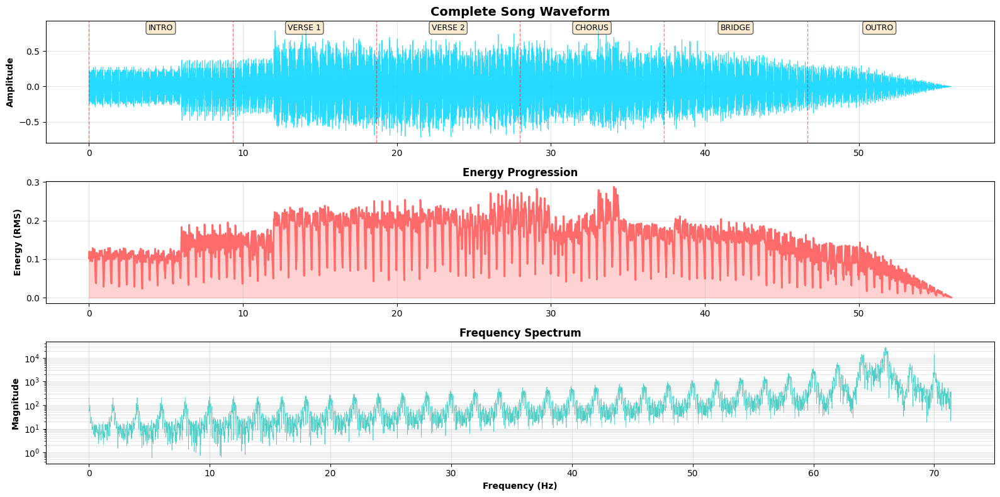

In [8]:
fig, axes = plt.subplots(3, 1, figsize=(16, 8))

time = np.linspace(0, len(song)/44100, len(song))

# Full waveform
axes[0].plot(time, song, linewidth=0.5, color='#00D4FF', alpha=0.8)
axes[0].fill_between(time, song, alpha=0.2, color='#00D4FF')
axes[0].set_ylabel('Amplitude', fontweight='bold')
axes[0].set_title('Complete Song Waveform', fontsize=14, fontweight='bold')
axes[0].grid(alpha=0.3)

# Mark sections
sections = ['INTRO', 'VERSE 1', 'VERSE 2', 'CHORUS', 'BRIDGE', 'OUTRO']
section_times = np.linspace(0, len(song)/44100, len(sections)+1)
for i, (start, end) in enumerate(zip(section_times[:-1], section_times[1:])):
    axes[0].axvline(start, color='red', linestyle='--', alpha=0.5, linewidth=1)
    axes[0].text((start + end)/2, 0.8, sections[i], ha='center', fontsize=9, 
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.6))

# Energy over time
window_size = 2048
hop_length = window_size // 2
energy = []
for i in range(0, len(song) - window_size, hop_length):
    window = song[i:i+window_size]
    energy.append(np.sqrt(np.mean(window**2)))
time_energy = np.linspace(0, len(song)/44100, len(energy))
axes[1].plot(time_energy, energy, color='#FF6B6B', linewidth=2)
axes[1].fill_between(time_energy, energy, alpha=0.3, color='#FF6B6B')
axes[1].set_ylabel('Energy (RMS)', fontweight='bold')
axes[1].set_title('Energy Progression', fontsize=12, fontweight='bold')
axes[1].grid(alpha=0.3)

# Frequency spectrum
fft = np.abs(np.fft.fft(song))
freqs = np.fft.fftfreq(len(song), 1/44100)
axes[2].semilogy(freqs[:4000], fft[:4000], linewidth=0.5, color='#4ECDC4')
axes[2].set_xlabel('Frequency (Hz)', fontweight='bold')
axes[2].set_ylabel('Magnitude', fontweight='bold')
axes[2].set_title('Frequency Spectrum', fontsize=12, fontweight='bold')
axes[2].grid(alpha=0.3, which='both')

plt.tight_layout()
plt.show()

## Play the Song

In [9]:
print('▶️  Playing complete quantum-generated song:')
ipd.display(synth.play_audio(song))

▶️  Playing complete quantum-generated song:


## Save the Song

In [10]:
synth.save_wav(song, 'quantum_song_60s.wav', volume=0.85)
print('✓ Song saved: quantum_song_60s.wav')

✓ Saved: quantum_song_60s.wav (56.00s)
✓ Song saved: quantum_song_60s.wav


## Generate Different Songs (Different Scales & Progressions)

In [17]:
# Generate multiple songs with different characteristics
song_configs = [
    {'scale': 'A_minor', 'progression': 'jazz', 'bpm': 100, 'filename': 'quantum_jazz.wav'},
    {'scale': 'E_minor', 'progression': 'blues', 'bpm': 90, 'filename': 'quantum_blues.wav'},
    {'scale': 'G_major', 'progression': 'epic', 'bpm': 140, 'filename': 'quantum_epic.wav'},
    {'scale': 'Cm_pentatonic', 'progression': 'pop', 'bpm': 110, 'filename': 'quantum_modal.wav'},
]

for config in song_configs:
    print(f'\nGenerating: {config["scale"]} {config["progression"]} at {config["bpm"]} BPM')
    print('='*60)
    
    comp = QuantumSongComposer(
        synth,
        bpm=config['bpm'],
        scale=config['scale'],
        progression=config['progression']
    )
    
    song_variant = comp.compose_complete_song(total_duration=50)
    synth.save_wav(song_variant, config['filename'], volume=0.85)


Generating: A_minor jazz at 100 BPM
Composing 50s song in A_minor scale...
Progression: jazz | BPM: 100
[1/5] INTRO (drums fade in)...
[2/5] VERSE 1 (drums + bass)...
[3/5] VERSE 2 (drums + bass + melody)...
[3/5] VERSE 2 (drums + bass + melody)...
[4/5] CHORUS (full arrangement)...
[4/5] CHORUS (full arrangement)...
[5/5] BRIDGE (transposed)...
      OUTRO (fade out)...
[5/5] BRIDGE (transposed)...
      OUTRO (fade out)...

Mixing tracks...

✓ Song completed: 45.60s
✓ Saved: quantum_jazz.wav (45.60s)

Generating: E_minor blues at 90 BPM
Composing 50s song in E_minor scale...
Progression: blues | BPM: 90
[1/5] INTRO (drums fade in)...
[2/5] VERSE 1 (drums + bass)...

Mixing tracks...

✓ Song completed: 45.60s
✓ Saved: quantum_jazz.wav (45.60s)

Generating: E_minor blues at 90 BPM
Composing 50s song in E_minor scale...
Progression: blues | BPM: 90
[1/5] INTRO (drums fade in)...
[2/5] VERSE 1 (drums + bass)...
[3/5] VERSE 2 (drums + bass + melody)...
[3/5] VERSE 2 (drums + bass + melod

## Play All songs

In [18]:
# Play all generated songs
print('\n' + '='*60)
print('PLAYING ALL GENERATED SONGS')
print('='*60)

for config in song_configs:
    print(f'\n▶️  Playing: {config["filename"]} ({config["scale"]} - {config["progression"]} @ {config["bpm"]} BPM)')
    # Load and play the saved file
    from scipy.io import wavfile
    sample_rate, audio_data = wavfile.read(config['filename'])
    # Convert from int16 to float
    audio_float = audio_data.astype(np.float32) / 32767.0
    ipd.display(ipd.Audio(audio_float, rate=sample_rate))
    print('-'*60)


PLAYING ALL GENERATED SONGS

▶️  Playing: quantum_jazz.wav (A_minor - jazz @ 100 BPM)


------------------------------------------------------------

▶️  Playing: quantum_blues.wav (E_minor - blues @ 90 BPM)


------------------------------------------------------------

▶️  Playing: quantum_epic.wav (G_major - epic @ 140 BPM)


------------------------------------------------------------

▶️  Playing: quantum_modal.wav (Cm_pentatonic - pop @ 110 BPM)


------------------------------------------------------------


## Compare Different Bass Patterns

Comparing different bass patterns at 120 BPM in C Major...


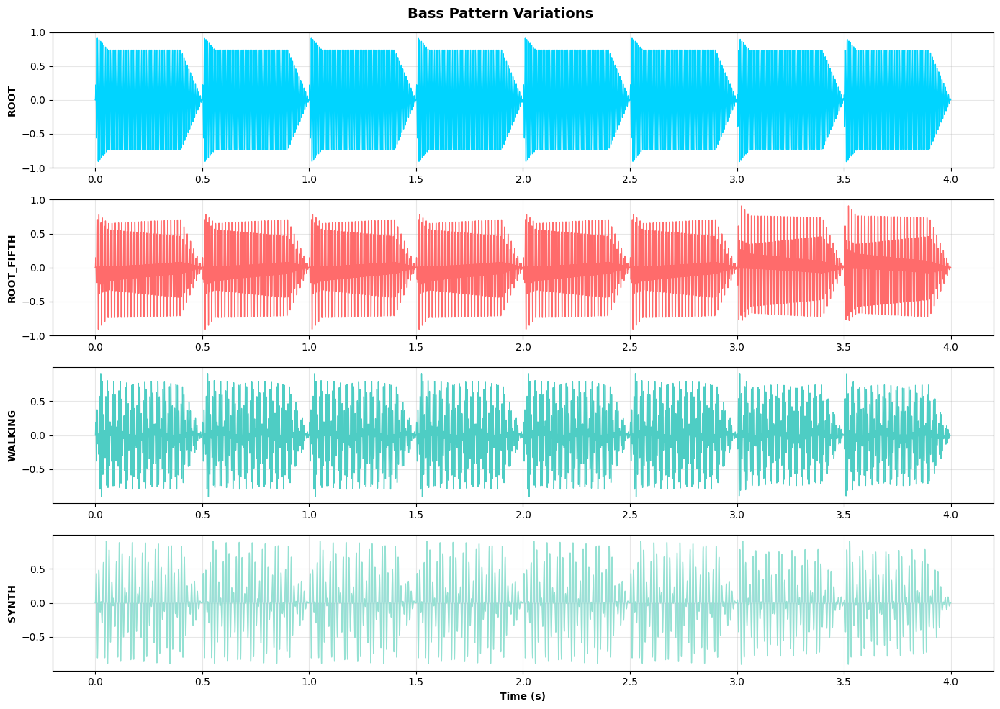

In [19]:
print('Comparing different bass patterns at 120 BPM in C Major...')
print('='*60)

bass_patterns = ['root', 'root_fifth', 'walking', 'synth']

fig, axes = plt.subplots(len(bass_patterns), 1, figsize=(14, 10))

for idx, pattern in enumerate(bass_patterns):
    comp = QuantumSongComposer(synth, bpm=120, scale='C_major')
    
    # Generate 8 beats with specific bass pattern
    bass_audio = np.array([])
    for beat in range(8):
        bass_beat = comp.generate_bass_line(bass_pattern=pattern, variation=beat * 0.1)
        bass_audio = np.concatenate([bass_audio, bass_beat])
    
    time_axis = np.linspace(0, len(bass_audio)/44100, len(bass_audio))
    axes[idx].plot(time_axis, bass_audio, linewidth=1, color=['#00D4FF', '#FF6B6B', '#4ECDC4', '#95E1D3'][idx])
    axes[idx].fill_between(time_axis, bass_audio, alpha=0.3)
    axes[idx].set_ylabel(pattern.upper(), fontweight='bold')
    axes[idx].grid(alpha=0.3)

axes[-1].set_xlabel('Time (s)', fontweight='bold')
plt.suptitle('Bass Pattern Variations', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## Summary: Full Professional Song Generation

In [23]:
print('\n' + '='*70)
print('PROFESSIONAL QUANTUM MUSIC GENERATION')
print('='*70)

print("""
WHAT YOU CAN NOW GENERATE:

✓ MULTIPLE SCALES:
  - C Major, A Minor, G Major, E Minor, D Major, B Minor
  - F Major, Pentatonic, Blues scales
  - Custom transpositions

✓ DIFFERENT PROGRESSIONS:
  - Pop (I-vi-IV-I)
  - Blues (I-I-IV-I)
  - Jazz (I-ii-IV-V)
  - Epic (I-IV-V-I)

✓ BASS PATTERNS:
  - Root notes (simple)
  - Root + Fifth (harmonic)
  - Walking bass (complex)
  - Synth bass (modern)
  
✓ FULL SONG STRUCTURE:
  - Intro (drums fade in)
  - Verse 1 (drums + bass)
  - Verse 2 (drums + bass + melody)
  - Chorus (full arrangement, more active)
  - Bridge (transposed scale variation)
  - Outro (fade out)

✓ INSTRUMENT LAYERS:
  - Drums (rhythm section)
  - Bass (low-end foundation)
  - Melody (lead instrument)
  - Independent volume control per instrument

✓ VARIATIONS:
  - Variable BPM (60-180 bpm)
  - Quantum-generated variations
  - Different durations (30s-120s)
  - Effects (reverb, fade in/out)

GENERATED FILES:
  - quantum_song_60s.wav (60 seconds)
  - quantum_jazz.wav (A Minor, Jazz)
  - quantum_blues.wav (E Minor, Blues)
  - quantum_epic.wav (G Major, Epic)
  - quantum_modal.wav (Pentatonic, Pop)

TECHNICAL DETAILS:
  - Each section uses different quantum circuits
  - Amplitude from quantum probability
  - Phase from quantum states
  - MIDI to frequency conversion
  - ADSR envelope shaping
  - Multi-track mixing
  - 44.1kHz 16-bit WAV export
""")
print('='*70)


PROFESSIONAL QUANTUM MUSIC GENERATION

WHAT YOU CAN NOW GENERATE:

✓ MULTIPLE SCALES:
  - C Major, A Minor, G Major, E Minor, D Major, B Minor
  - F Major, Pentatonic, Blues scales
  - Custom transpositions

✓ DIFFERENT PROGRESSIONS:
  - Pop (I-vi-IV-I)
  - Blues (I-I-IV-I)
  - Jazz (I-ii-IV-V)
  - Epic (I-IV-V-I)

✓ BASS PATTERNS:
  - Root notes (simple)
  - Root + Fifth (harmonic)
  - Walking bass (complex)
  - Synth bass (modern)
  
✓ FULL SONG STRUCTURE:
  - Intro (drums fade in)
  - Verse 1 (drums + bass)
  - Verse 2 (drums + bass + melody)
  - Chorus (full arrangement, more active)
  - Bridge (transposed scale variation)
  - Outro (fade out)

✓ INSTRUMENT LAYERS:
  - Drums (rhythm section)
  - Bass (low-end foundation)
  - Melody (lead instrument)
  - Independent volume control per instrument

✓ VARIATIONS:
  - Variable BPM (60-180 bpm)
  - Quantum-generated variations
  - Different durations (30s-120s)
  - Effects (reverb, fade in/out)

GENERATED FILES:
  - quantum_song_60s.wav